https://mathworld.wolfram.com/q-PolygammaFunction.html

The $q$-digamma function $\psi_q(z)$ can be defined by

$$
\psi_q(z) = \log(1 - q) + \log(q) \sum_{n=0}^\infty \frac{1}{q^{-(n+z)} - 1}.
$$

Let us plot the graph of $\displaystyle \tilde{\psi}_q(z) = \sum_{n=0}^\infty \frac{1}{q^{-(n+z)} - 1}$.

In [1]:
using CUDA
using Plots
default(fmt=:png)
using Printf

approxlogabs(x; a=0.1) = (abs(x)^a - 1)/a

qdigamma(q, z; L=100) = sum(n -> 1/(q ^ (-(n+z)) - 1), 0:L)

function qdigammadot(q, z; L=100)
    w = zero(q)
    for n in 0:L
        w .+= 1 ./ (q .^ (-(n+z)) .- 1)
    end
    w
end

function plot_qdigamma(;
        z=1,
        L=100,
        f=approxlogabs, 
        size=(500, 520),
        color=:glasbey_bw_minc_20_hue_150_280_n256,
        q=complex.(range(-1.1, 1.1, 400)', range(-1.1, 1.1, 400)),
        title="z = $(@sprintf "%5.2f" z),  f = $f", 
        kwargs...
    )
    w = qdigammadot(q, z; L)
    a = f.(w)
    x, y = real(q[1,:]), imag(q[:,1])
    heatmap(Array(x), Array(y), Array(a); colorbar=false, color, size, title, kwargs...)
end

plot_qdigamma (generic function with 1 method)

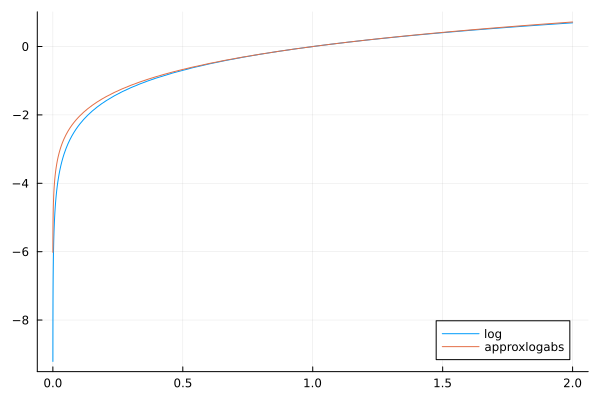

In [2]:
plot(log, 0.0001, 2; label="log")
plot!(approxlogabs, 0.0001, 2; label="approxlogabs")

typeof(q) = Matrix{ComplexF64}
  5.915135 seconds (458.51 k allocations: 34.627 MiB, 0.17% gc time, 3.78% compilation time)
 11.994378 seconds (2.39 k allocations: 8.778 MiB, 0.40% compilation time: 21% of which was recompilation)


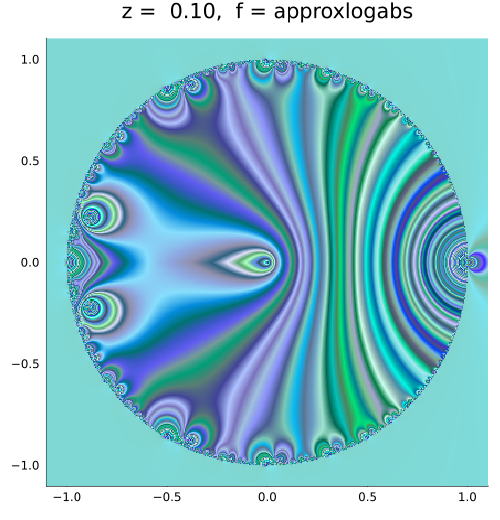

In [3]:
q = complex.(range(-1.1, 1.1, 400)', range(-1.1, 1.1, 400))
@show typeof(q)
@time a = approxlogabs.(qdigammadot(q, 2.0; L=1000))
@time plot_qdigamma(; z=0.1, L=1000)

typeof(q_cu) = CuArray{ComplexF64, 2, CUDA.DeviceMemory}
  9.722622 seconds (13.85 M allocations: 961.007 MiB, 2.70% gc time, 91.84% compilation time: <1% of which was recompilation)
  0.014397 seconds (80.21 k allocations: 1.700 MiB)
  0.386575 seconds (80.19 k allocations: 1.698 MiB)
  2.846592 seconds (2.90 M allocations: 208.067 MiB, 1.45% gc time, 71.32% compilation time)


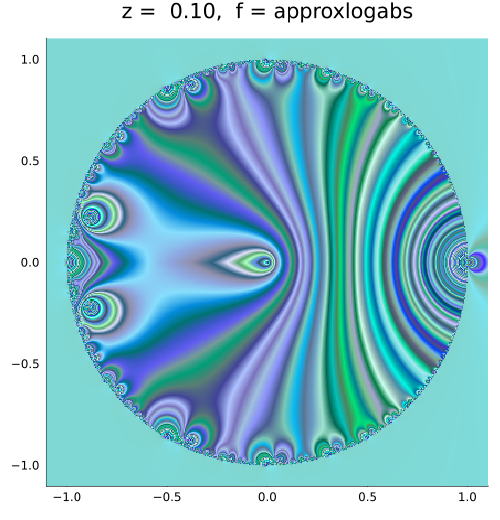

In [4]:
q = complex.(range(-1.1, 1.1, 400)', range(-1.1, 1.1, 400))
q_cu = CuArray(q)
@show typeof(q_cu)
@time a = approxlogabs.(qdigammadot(q_cu, 2.0; L=1000))
@time a = approxlogabs.(qdigammadot(q_cu, 2.0; L=1000))
@time a = approxlogabs.(qdigammadot(q_cu, 2.0; L=1000))
@time plot_qdigamma(; z=0.1, L=1000, q=q_cu)

In [5]:
q = q_cu; # Comment out this line if you don't use CUDA.

  0.713279 seconds (360.35 k allocations: 24.461 MiB, 18.43% compilation time)


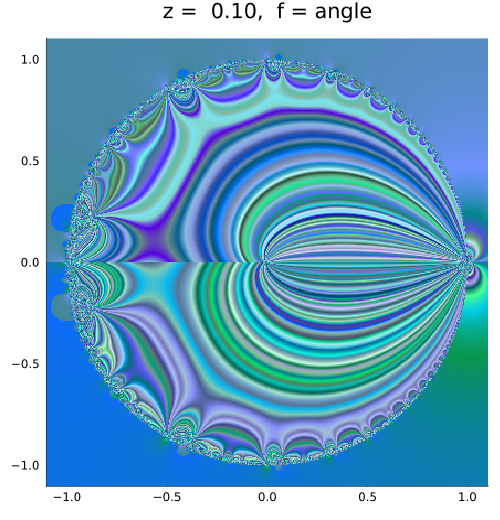

In [6]:
@time plot_qdigamma(; z=0.1, f=angle, L=1000, q)

  0.608843 seconds (501.47 k allocations: 38.048 MiB, 17.53% gc time, 29.08% compilation time)


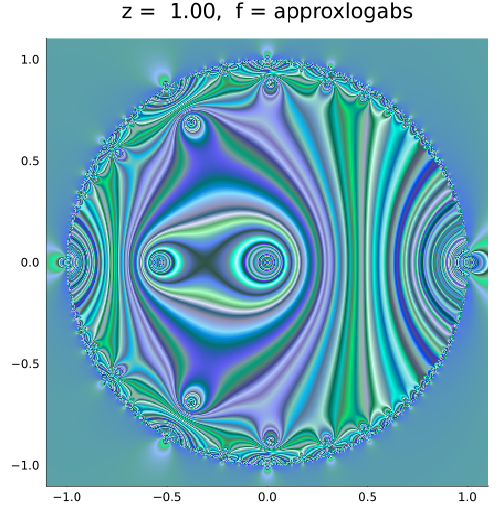

In [7]:
@time plot_qdigamma(; z=1, q)

  0.091874 seconds (35.03 k allocations: 4.509 MiB, 14.53% compilation time)


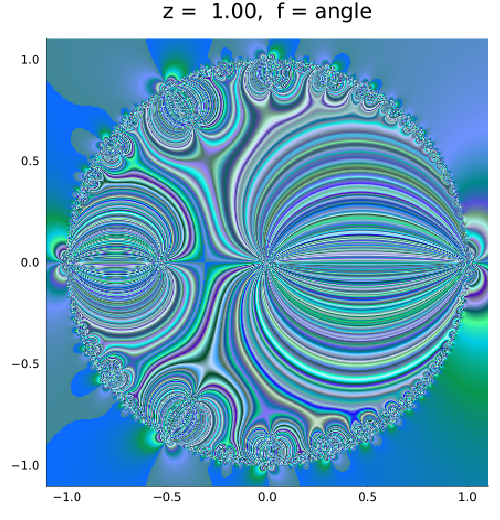

In [8]:
@time plot_qdigamma(; z=1, f=angle, q)

  0.094645 seconds (9.07 k allocations: 2.746 MiB)


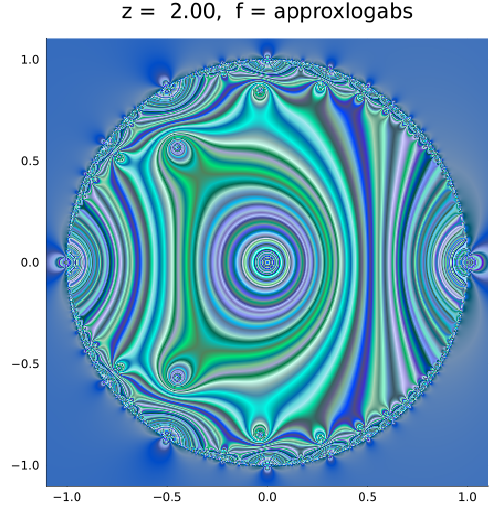

In [9]:
@time plot_qdigamma(; z=2, q)

  0.099058 seconds (9.06 k allocations: 2.746 MiB)


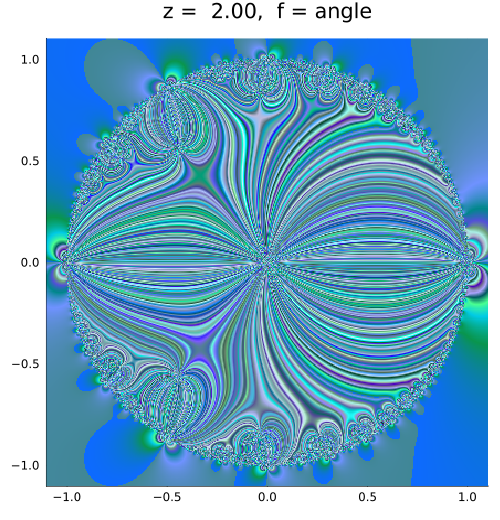

In [10]:
@time plot_qdigamma(; z=2, f=angle, q)

 22.443485 seconds (150.18 M allocations: 5.026 GiB, 2.54% gc time, 0.39% compilation time)


[ Info: Saved animation to D:\OneDrive\public\0049\qdigamma.gif


Plots.AnimatedGif("D:\\OneDrive\\public\\0049\\qdigamma.gif")
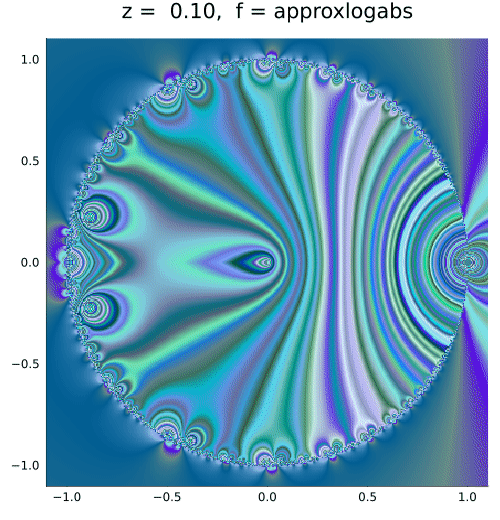

In [11]:
@time anim = @animate for z in [fill(0.1, 10); 0.1:0.02:2; fill(2.0, 10)]
    plot_qdigamma(; z=z, clim=(-5.65, 9.95), q)
end
gif(anim, "qdigamma.gif")

 23.089900 seconds (150.04 M allocations: 5.024 GiB, 2.32% gc time, 0.04% compilation time)


[ Info: Saved animation to D:\OneDrive\public\0049\qdigamma2.gif


Plots.AnimatedGif("D:\\OneDrive\\public\\0049\\qdigamma2.gif")
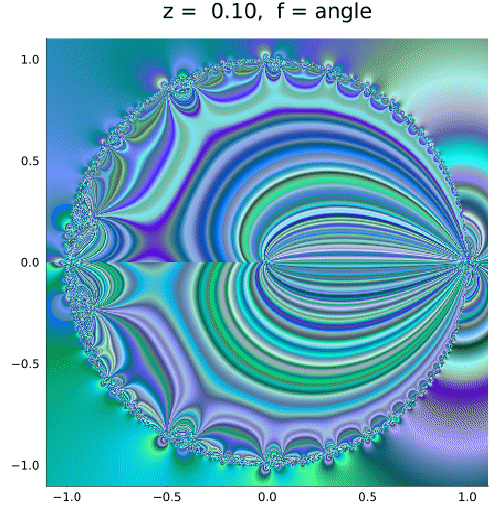

In [12]:
@time anim = @animate for z in [fill(0.1, 10); 0.1:0.02:2; fill(2.0, 10)]
    plot_qdigamma(; z=z, f=angle, q)
end
gif(anim, "qdigamma2.gif")